In [1]:
from pathlib import Path
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from asdf import AsdfFile
from abacusnbody.data.compaso_halo_catalog import CompaSOHaloCatalog
import multiprocessing
import time
#from playsound import playsound
import math
nthreads=16
import abacusnbody.data.asdf
abacusnbody.data.asdf.set_nthreads(nthreads)

from scipy.optimize import minimize
import statsmodels.api as sm

path2config='config/abacus_hod.yaml'
path="./AbacusSummit_base_c000_ph000/halos/z0.100/halo_info/"
catdir = Path(path)
import funcProject
from funcProject import*
#Read the calalogues and output position (x,y,z) multi-processing

%matplotlib widget

# Estimate average density at a distance r from the CoM of halo
params2=np.array([0,0])      
from scipy.optimize import curve_fit

In [2]:
st=time.time()
cat=read3(path,4,6)
#cat.halos = {key: cat.halos[key] for key in ['id', 'npstartA','npoutA','x_com', 'x_L2com', 'v_com','N_merge', 'is_merged_to','haloindex','SO_central_density','N']}
#hal = {key: cat.halos[key] for key in ['id', 'npstartA','npoutA','x_com']}
L = cat.header['BoxSize']
print(time.time()-st)
#playsound('./Notificaton_tune/Programming_Complete.mp3')
rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]


395.6653616428375


In [24]:
cat.halos = {key: cat.halos[key] for key in ['id', 'npstartA','npoutA','x_com', 'x_L2com', 'v_com','N_merge', 'is_merged_to','haloindex','SO_central_density','N']}
hal = {key: cat.halos[key] for key in ['id', 'npstartA','npoutA','x_com']}

In [3]:
plt.rcParams["font.family"]="Times New Roman"
plt.rcParams["font.sans-serif"]="Times New Roman"
plt.rcParams['font.serif']="Times New Roman"
plt.rcParams["font.size"]=12

In [4]:

plt.rcParams['font.family'] = 'Times New Roman'
import matplotlib.font_manager as fm
# Get the path to the Times New Roman font file
font_path = fm.findfont(fm.FontProperties(family='Times New Roman'))

# Set the math font to be the same as the regular font
plt.rcParams['mathtext.fontset'] = 'custom'
plt.rcParams['mathtext.rm'] = 'Times New Roman'
plt.rcParams['mathtext.it'] = 'Times New Roman:italic'
plt.rcParams['mathtext.bf'] = 'Times New Roman:bold'
plt.rcParams['mathtext.fontset'] = 'custom'
plt.rcParams['mathtext.default'] = 'rm'


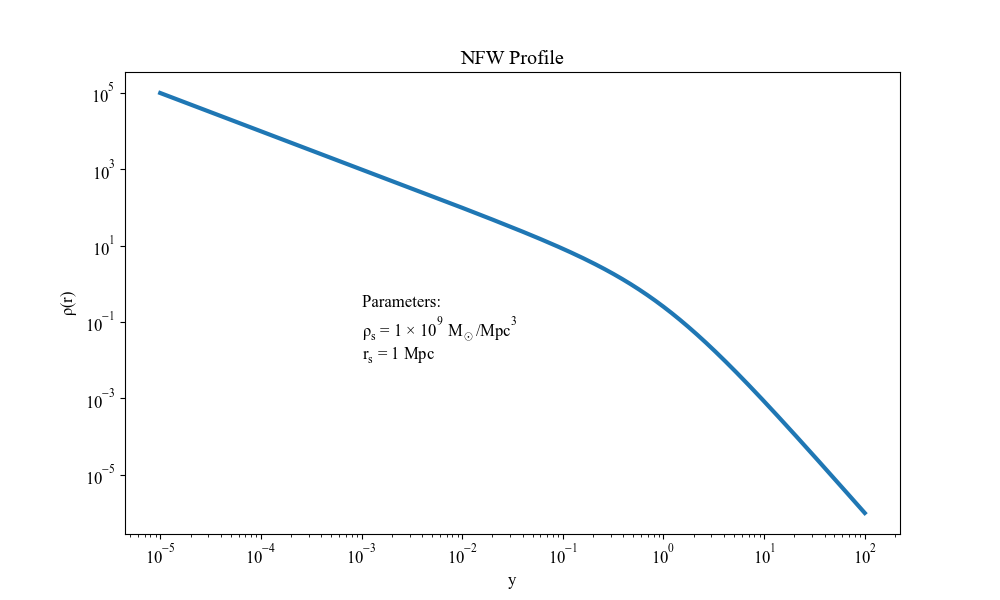

In [5]:
fignfw, ax = plt.subplots(figsize=((10,6)))
x=np.linspace(0.00001,100,10000)
rho_s=1
r_s=1
y=nfw(x,rho_s,r_s)
#ax.plot(np.log10(x),np.log10(y))
ax.plot(x,y,linewidth=3)
ax.set_xlabel("y",family="Times New Roman")
ax.set_ylabel("$\u03C1(r)$")
ax.set_title("NFW Profile")
#plt.xscale('symlog')
#plt.yscale('symlog')
#ax.axis([1, 10000, 1, 100000])
ax.annotate(f"Parameters: \n$\u03c1_s$ = {rho_s} \u00d7 $10^9$ $M_\odot$/$Mpc^3$\n$r_s$ = {r_s} Mpc", xy=(.001,.01))
ax.loglog()
plt.show()

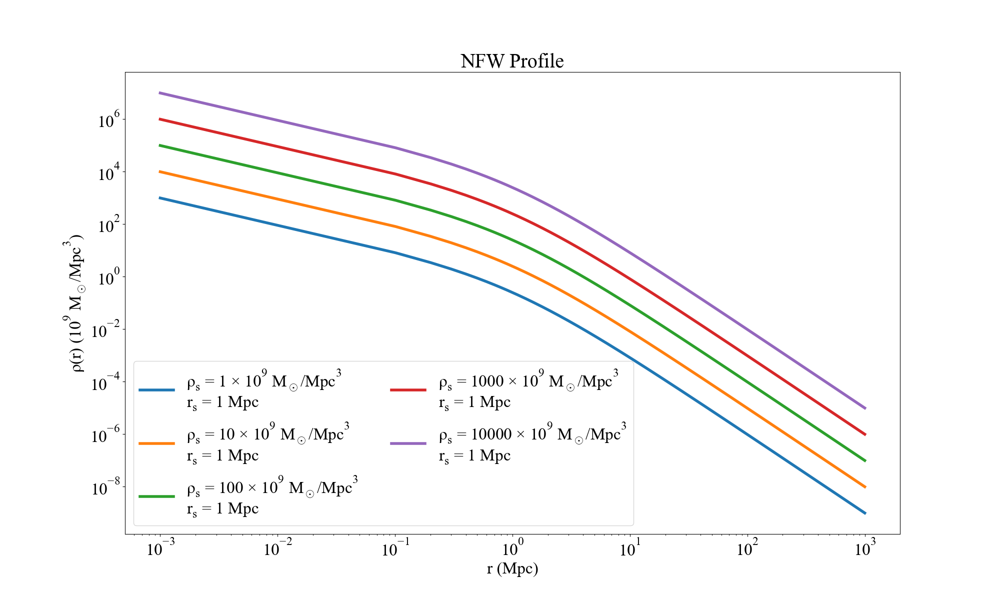

In [163]:

fignfw, ax = plt.subplots(figsize=((20,12)))


plt.rcParams["font.size"]=24
x=np.linspace(0.001,1000,10000)
for i in range(5):
    rho_s=10**i
    r_s=1
    y=nfw(x,rho_s,r_s)
    #ax.plot(np.log10(x),np.log10(y))
    ax.plot(x,y,linewidth=4, label=f"$\u03c1_s$ = {rho_s} \u00d7 $10^9$ $M_\odot$/$Mpc^3$\n$r_s$ = {r_s} Mpc")
ax.set_xlabel("r (Mpc)")
ax.set_ylabel("$\u03C1(r)$ ($10^9$ $M_\odot$/$Mpc^3$)")
ax.set_title("NFW Profile")
#plt.xscale('symlog')
#plt.yscale('symlog')
#ax.axis([1, 10000, 1, 100000])
#ax.annotate(f"Parameters: \n$\u03c1_s$ = {rho_s} \u00d7 $10^9$ $M_\odot$/$Mpc^3$\n$r_s$ = {r_s} Mpc", xy=(.001,.01))
ax.legend(ncol=2)
ax.loglog()
plt.show()

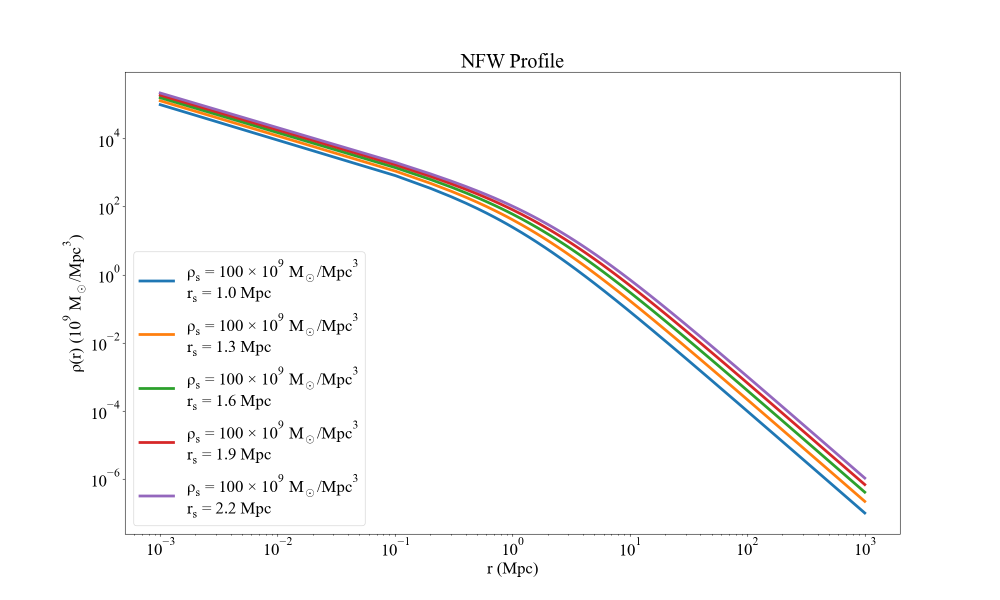

In [162]:
fignfw, ax = plt.subplots(figsize=((20,12)))


plt.rcParams["font.size"]=24
x=np.linspace(0.001,1000,10000)
for i in range(5):
    rho_s=100
    r_s=1+i*.3
    y=nfw(x,rho_s,r_s)
    #ax.plot(np.log10(x),np.log10(y))
    ax.plot(x,y,linewidth=4, label=f"$\u03c1_s$ = {rho_s} \u00d7 $10^9$ $M_\odot$/$Mpc^3$\n$r_s$ = {r_s} Mpc")
ax.set_xlabel("r (Mpc)")
ax.set_ylabel("$\u03C1(r)$ ($10^9$ $M_\odot$/$Mpc^3$)")
ax.set_title("NFW Profile")
#plt.xscale('symlog')
#plt.yscale('symlog')
#ax.axis([1, 10000, 1, 100000])
#ax.annotate(f"Parameters: \n$\u03c1_s$ = {rho_s} \u00d7 $10^9$ $M_\odot$/$Mpc^3$\n$r_s$ = {r_s} Mpc", xy=(.001,.01))
ax.legend()
ax.loglog()
plt.show()

In [ ]:
Import numpy as np
=cat.halos['id'](np.where(cat.halos['N']==cat.halos['N']>10000))


16863.814967276725 0.6125383423378127


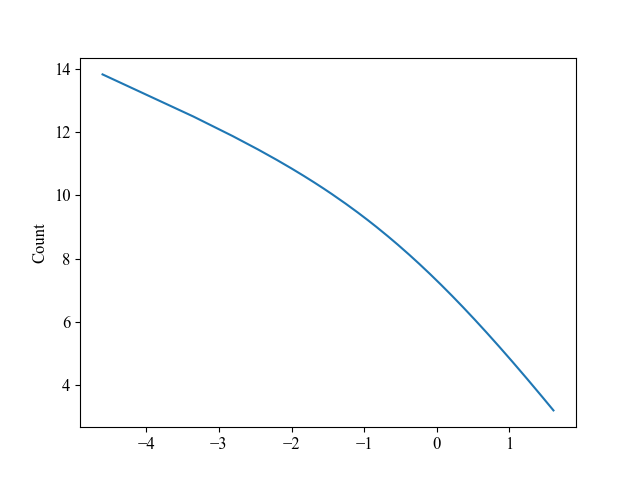

In [37]:
#rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]
fig_nfw=plt.figure()
for num in mass_range[:1]:
    #num=191065
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    #r1=r_max*.1
    r1=.8
    r2=1.5
    #r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    m2=len(np.where(x_r<=r2)[0])* 100/3 * m
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    rho_s=f_rho_s(r_s,r1,m1)/rho_mean
    print(rho_s,r_s)
    r=np.linspace(.01,5,200)
    y=nfw(r,rho_s,r_s)
    #print(y)
    #plt.xlim(.01,3)
    #plt.plot(r,y)
    plt.plot(np.log(r),np.log(y))
    plt.ylabel('Count', family='Times New roman')
plt.show()

685843122082644.5 0.6125383423378127


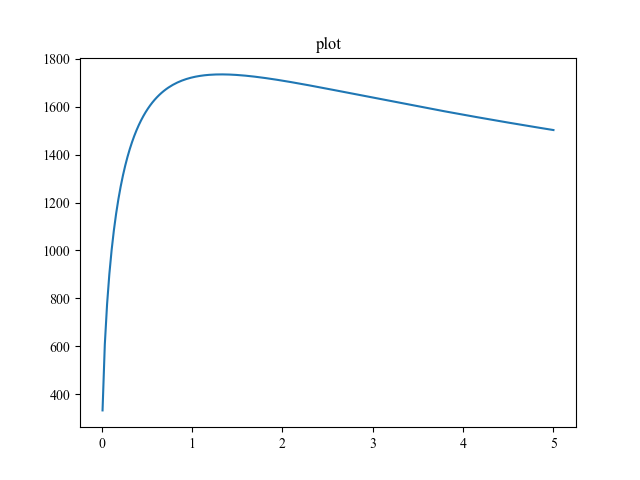

In [26]:
rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]
fig_nfw=plt.figure()
for num in mass_range[:1]:
    #num=191065
    num=28694
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    #r1=r_max*.1
    r1=.8
    r2=1.5
    #r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    m2=len(np.where(x_r<=r2)[0])* 100/3 * m
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    rho_s=f_rho_s(r_s,r1,m1)
    print(rho_s,r_s)
    r=np.linspace(.01,5,200)
    y=nfw(r,rho_s,r_s)
    v=vel(r,rho_s,r_s)
    #print(y)
    #plt.xlim(.01,3)
    #plt.plot(r,y)
    #plt.plot(np.log(r),np.log(y))
    plt.plot(r,v)
plt.title("plot")
plt.show()

In [24]:
x_range=np.linspace(.1,3,9)
x2_range=np.linspace(.2,3.1,9)
x_range=np.repeat([.5],5)
x2_range=np.linspace(1,2,5)

for i in range(len(x_range)):
    for num in mass_range[:1]:
        num=191065
        m= cat.header["ParticleMassHMsun"]
        s=cat.halos["npstartA"][num]
        M=cat.halos["npoutA"][num]
        B=cat.subsamples["pos"][s:s+M]
        x_r=x2r(cat.halos["x_com"][num])
        r_max=x_r.max()
        r1=x_range[i]
        r2=x2_range[i]
        m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
        m2=len(np.where(x_r<=r2)[0])* 100/3 * m
        r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
        rho_s=f_rho_s(r_s,r1,m1)/rho_mean
        print(rho_s,r_s)
        r=np.linspace(0,5,200)
        #plt.plot(r,nfw(r,rho_s,r_s))

44215.79315899788 0.39934440134483207
40611.04403505697 0.4188549142877385
42698.24409895923 0.40722007352426615
47561.402190770415 0.3834846265035818
52333.64959335095 0.36383509491308885


In [9]:
1710317986999919/40669511816

42054.05746540223

In [ ]:
1710317986999919.8

In [13]:
cat.subsamples["density"].max()

110224.0

In [ ]:
for num in mass_range[:1]:
    m= 2e9
    q=0
    s=cat.halos["npstartA"][num]
    q=q+1
    print(q)
    M=cat.halos["npoutA"][num]
    q=q+1
    print(q)
    B=cat.subsamples["pos"][s:s+M]
    q=q+1
    print(q)
    x_r=x2r(cat.halos["x_com"])
    q=q+1
    print(q)
    r_max=x2r.max()
    q=q+1
    print(q)
    r1=r_max*.2
    q=q+1
    print(q)
    r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    q=q+1
    print(q)
    m2=len(np.where(x_r<=r1)[0])* 100/3 * m
    q=q+1
    print(q)
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    q=q+1
    print(q)
    rho_s=f_rho_s(r_s,r1,m1)
    q=q+1
    print(q)
    r=np.lnspace(0,5,200)
    q=q+1
    print(q)
    plt.plot(r,nfw(r,rho_s,r_s))
plt.show()   

In [53]:
A=np.arange(10)
len((np.where(A<7)[0]))

7

In [7]:
cat.header["ParticleMassHMsun"]

2109081520.453063

##### To scatter plot a halo you call plot_halo("index")

In [7]:
import numpy as np
import multiprocessing
import numba
from numba import jit

#@jit(nopython=True)
def cnrt(x0,x):
    r=np.sqrt(sum((x0-x)*(x0-x)))
    z=x[2]-x0[2]
    y=x[1]-x0[1]
    x=x[0]-x0[0]
    theta=np.arccos(z/r)
    print(x**2+y**2)
    if(x>0):
        if (y >0):
            phi=np.arctan(x/y)
            #phi=np.arccos(x/r/np.sin(theta))
        else:
            phi=np.pi+np.arctan(x/y)
    else:
        if (y <0):
            phi=np.pi + np.arctan(x/y)
            #phi=np.arccos(x/r/np.sin(theta))
        else: 
            phi=2*np.pi + np.arctan(x/y)
    return ([r,theta,phi])

def con(B,x0):
    A=[cnrt(B[0],x0)]
    for i in range(1,len(B)):
        A=np.append(A,[cnrt(B[i],x0)],axis=0)
    return(A)

In [157]:
num=197341
varr=np.array(cat.subsamples["vel"][cat.halos["npstartA"][num]:cat.halos["npstartA"][num]+cat.halos["npoutA"][num]])
vhalo=np.array(cat.halos["v_com"][num])
xarr=np.array(cat.subsamples["pos"][cat.halos["npstartA"][num]:cat.halos["npstartA"][num]+cat.halos["npoutA"][num]])
xhalo=np.array(cat.halos["x_com"][num])
v_rad=varr*xarr/convert(xarr,xhalo)
v_mag=convert(varr,vhalo)



In [ ]:
con(varr,vhalo)

In [34]:
con(np.array([[1,2,3],[6,8,1]]),np.array([8,6,8]))

65
8


array([[9.48683298, 1.01567516, 1.05165021],
       [7.54983444, 0.38400234, 2.35619449]])

In [3]:
np.log(np.exp(1))

1.0

In [5]:
print(len(cat.subsamples["pos"]))

136195409


In [6]:
print(len(cat.halos["id"]))

277617


In [ ]:
st=time.time()
cat=read(4,7,read_1)
print(st-time.time())

In [164]:
type(cat)

abacusnbody.data.compaso_halo_catalog.CompaSOHaloCatalog

In [9]:
mass_range=[20795403]

In [147]:
halos={}
i=0
import math

# Choose the mass range; the indices are taken
mass_range=np.where((cat.halos['npoutA']<=(25000)) & (cat.halos['npoutA']>=(20000)))
mass_range=mass_range[0]
'''mass_range2=np.where((cat.halos['npoutA']<=(15000)) & (cat.halos['npoutA']>=(10000)))
mass_range2=mass_range2[0]
mass_range=np.append(mass_range[:3],mass_range2[:3])
mass_range2=np.where((cat.halos['npoutA']<=(10000)) & (cat.halos['npoutA']>=(5000)))
mass_range2=mass_range2[0]
mass_range=np.append(mass_range,mass_range2[:3])'''
col=3
params_arr=np.array([0,0])
for num in mass_range[:]:
    #num=index_of_halo
    M=cat.halos['npoutA'][num]
    s=cat.halos['npstartA'][num]
    
    # Find all the subsample partifcle assiciated with a halo
    B=cat.subsamples['pos'][s:s+M,:]
    r=np.linspace(0.001,5,501)
    x0=cat.halos['x_com'][num]
    
    # Corvet to sperical-polar coordinate
    r_value=x2r(x0)
    
    # Estimate the the average density at a distance r for CoM of the halo
    denAt_r_l=density(r,r_value,s,cat.subsamples["density"])
    denAt_r=denAt_r_l[0]
    l=denAt_r_l[1]
    #print(l)
    if(len(denAt_r)==0):
        print(f"*******halo skiped(index: {num} no. of subsample particles: {cat.halos['npoutA'][num]}")
        continue
    else:
        print(f"halo {i+1}/{len(mass_range)} processed successfully (index: {num} no. of subsample particles: {cat.halos['npoutA'][num]}")
    m=np.where(denAt_r==max(denAt_r))
    m=m[0][0]
    
    # Adjusted range of x and y to some appropriate value*
    x=(r[m:l])
    #x=r[:l]
    y=(denAt_r[m:l])
    params=fit()

    import math
    params_arr=np.vstack((params_arr,params) )
    halos[i]=[x,y,nfw(x,params[0],params[1])]
    i+=1

params_arr = np.delete(params_arr, 0, 0)    

print("####################################################################################\n                                        Done!\n####################################################################################")



halo 1/11 processed successfully (index: 28694 no. of subsample particles: 22384
halo 2/11 processed successfully (index: 80258 no. of subsample particles: 21772
halo 3/11 processed successfully (index: 81313 no. of subsample particles: 21755
halo 4/11 processed successfully (index: 82685 no. of subsample particles: 20142
halo 5/11 processed successfully (index: 95703 no. of subsample particles: 23067
halo 6/11 processed successfully (index: 167990 no. of subsample particles: 21292
halo 7/11 processed successfully (index: 171434 no. of subsample particles: 22208
halo 8/11 processed successfully (index: 181793 no. of subsample particles: 22692
halo 9/11 processed successfully (index: 191065 no. of subsample particles: 20474
halo 10/11 processed successfully (index: 197341 no. of subsample particles: 24393
halo 11/11 processed successfully (index: 212415 no. of subsample particles: 23512
####################################################################################
                

In [13]:
def h(a1,end1):
    A=np.zeros((end1-a1,rhol))  
    l=0
    for j in range(a1,end1):
        for s in range(rhol): 
            x1=0
            for k in range(len(x)):
                rho=y[k]
                rho_s=rhos[s]
                r_s=rs_s[j]
                rhoA=nfw(x[k],rho_s,r_s)
                x1=x1+((rho-rhoA)/rhoA)**2 
            
            A[l][s]=x1
        l=l+1
    return(A)

### Plot the NFW profile (Not fitting)

In [23]:
s=2
print(math.frexp(s))

(0.5, 2)


/tmp/ipykernel_514/3848811579.py:36: RuntimeWarning: divide by zero encountered in log
  ax[int(i/col),int(i%col)].plot(np.log(halos[i][0]), np.log(halos[i][1]), label="Data")


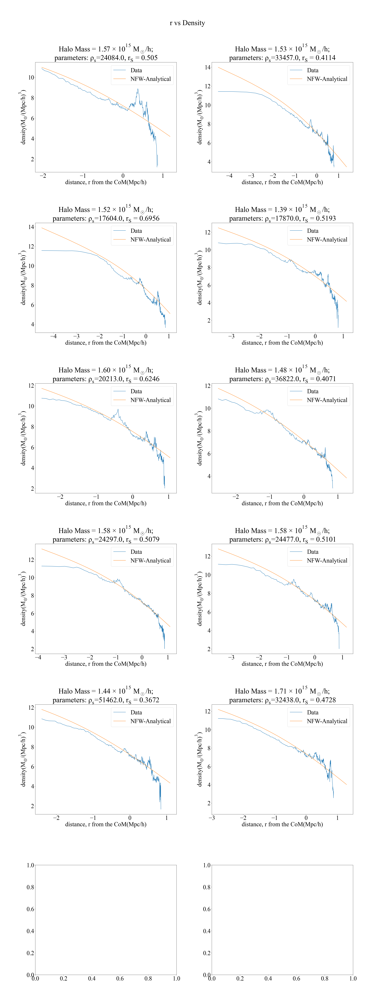

In [151]:
import math

plt.clf()
col=2

fig1_1_, ax = plt.subplots(nrows=(math.ceil(len(halos)/col)), ncols=col,figsize=(30, 80))#,sharey='row', sharex='col'))

fig1_1_.tight_layout(pad=5.0)
 # your plotting code 
plt.rcParams["font.size"]=35
 # create a new formatter and use it on the y-axis
#formatter = mticker.ScalarFormatter(useMathText=True)
#ax.yaxis.set_major_formatter(formatter)
#tick_formatter = plt.FuncFormatter(lambda x, pos: fmt.format(x))
#ax.yaxis.set_major_formatter(tick_formatter)
for i in range(0,len(halos)-1,1):
    num=mass_range[i]
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    #r1=r_max*.1
    r1=.5
    r2=.8
    #r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    m2=len(np.where(x_r<=r2)[0])* 100/3 * m
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    rho_s=f_rho_s(r_s,r1,m1)/rho_mean
    #print(rho_s,r_s)
    r=np.linspace(min(halos[i][0]),max(halos[i][0]),200)
    #r=np.linspace(.01,5,200)
    y=nfw(r,rho_s,r_s)
    ax[int(i/col),int(i%col)].plot(np.log(halos[i][0]), np.log(halos[i][1]), label="Data")
    #ax[int(i/col),int(i%col)].plot(np.log(halos[i][0]),np.log(halos[i][2]), color='red',label="NFW-Fitted")
    ax[int(i/col),int(i%col)].plot(np.log(r),np.log(y),label="NFW-Analytical")
    ax[int(i/col),int(i%col)].set_xlabel("distance, r from the CoM(Mpc/h)")
    ax[int(i/col),int(i%col)].set_ylabel("density($M_\u2609/(Mpc/h)^3)$")
    ax[int(i/col),int(i%col)].legend(loc='upper right')
    exp=str(len(str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0)))-3)
    mand=str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0))
    #print(mand)
    mand=mand[0]+"."+mand[1:3]
    p=np.round(params_arr[i,0],2)
    rad=np.round(params_arr[i,1],2)
    
    ax[int(i/col),int(i%col)].title.set_text(f'Halo Mass = {mand} $\u00d7$ $10^1$$^{exp[1]}$ $M_\odot/h$; \nparameters: $\u03C1_s$={np.round(rho_s,0)}, $r_S$ = {np.round(r_s,4)}')
fig1_1_.suptitle('r vs Density')
fig1_1_.tight_layout(pad=3.0)
plt.show()

In [27]:
len(str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0)))-3

18

In [28]:
str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0))

'1647521684191033.0'

In [7]:
cat.halos.keys()

dict_keys(['id', 'npstartA', 'npoutA', 'x_com', 'x_L2com', 'v_com', 'N_merge', 'is_merged_to', 'haloindex', 'SO_central_density'])

In [8]:
cat.subsamples

pid,lagr_pos,lagr_idx,tagged,density,pos,vel
int64,float32[3],int16[3],bool,float32,float32[3],float32[3]
5708011799341,-764.75696 .. -615.4514,813 .. 1329,True,100.0,-763.996 .. -602.366,55.664062 .. 647.46094
5815388144436,-762.7315 .. -608.2176,820 .. 1354,False,169.0,-763.872 .. -602.938,128.90625 .. 1227.5391
5772437488438,-762.1528 .. -611.1111,822 .. 1344,True,121.0,-763.792 .. -602.928,155.27344 .. 720.7031
5738077356830,-769.0972 .. -613.4259,798 .. 1336,True,676.0,-763.774 .. -602.726,55.664062 .. 788.08594
5750962455326,-769.0972 .. -612.55786,798 .. 1339,True,289.0,-763.794 .. -602.66,-87.890625 .. 1004.8828
5811091866414,-764.4676 .. -608.50696,814 .. 1353,True,289.0,-763.832 .. -602.618,266.60156 .. 955.0781
5733782717218,-767.9398 .. -613.7153,802 .. 1335,True,484.0,-763.73 .. -602.62,5.859375 .. 796.875
5798207292198,-766.7824 .. -609.375,806 .. 1350,True,196.0,-763.892 .. -602.446,357.42188 .. 295.89844
5742371668788,-762.7315 .. -613.1366,820 .. 1337,True,324.0,-764.028 .. -602.246,369.14062 .. 527.34375


In [46]:
num=np.where(cat.halos["npoutA"]==max(cat.halos["npoutA"]))
num=num[0][0]

In [127]:
vel(np.array([1,2,3]),11000,2)

array([0.0185221 , 0.02143167, 0.02239285])

In [ ]:
halos={}
u=0

# Choose the mass range; the indices are taken
mass_range=np.where((cat.halos['npoutA']<=(25000)) & (cat.halos['npoutA']>=(20000)))
mass_range=mass_range[0]

print(mass_range)

#mass_range=[20795403]
for num in mass_range:
    #num=index_of_halo
    M=cat.halos['npoutA'][num]
    s=idA=cat.halos['npstartA'][num]
    
    # Find all the subsample partifcle assiciated with a halo
    B=cat.subsamples['pos'][s:s+M,:]
    r=np.linspace(0.001,5,1001)
    x0=cat.halos['x_com'][num]
    
    # Corvet to sperical-polar coordinate
    r_value=x2r(x0)
    
    # Estimate the the average density at a distance r for CoM of the halo
    denAt_r_l=density(r,r_value,s,cat.subsamples["density"])
    denAt_r=denAt_r_l[0]
    l=denAt_r_l[1]
    #print(l)
    
    if(len(denAt_r)==0):
        print(f"*******halo skiped(index: {num} no. of subsample particles: {cat.halos['npoutA'][num]}")
        continue
    else:
        print(f"halo {u+1}/{len(mass_range)} processed successfully (index: {num} no. of subsample particles: {cat.halos['npoutA'][num]}")
        
    # Find the point with maximum density
    m=np.where(denAt_r==max(denAt_r))
    m=m[0][0]
    
    # Adjusted range of x and y to some appropriate value*
    x=(r[m:l])
    #x=r[:l]
    y=(denAt_r[m:l])
    
    #x=np.log(x)
    #y=np.log(y)
    #y=denAt_r[:l]
    data=fit(r,denAt_r,l)
    halos[u]=data
    u+=1
print("####################################################################################\n                                        Done!\n####################################################################################")
#dictionary data structure: x,y,y_fit   
#print(halos)
playsound('/home/kiran-m-r/Music/Notificaton_tune/Programming_Complete.mp3')

In [ ]:
len(params_arr)
fig3=plt.figure()
radius=np.linspace(0.001,100000,10000)

for w in range(len(params_arr[:3])):
    plt.plot(radius,vel(radius,params_arr[w,0],params_arr[w,0]),label=str(params_arr[w]))
    plt.plot()
    
plt.legend()
plt.show()

In [ ]:
col=3
#Index of the halo
fig2_1, ax2 = plt.subplots(nrows=(math.ceil(len(halos)/col)), ncols=col,figsize=(18, int(1.5*len(halos))))

i=0
for num in mass_range[:]:

    # Select the subsample particle associated with  a halo
    s = cat.halos["npstartA"][num]
    M = cat.halos["npoutA"][num]

    # Velocity of CoM of the host halo
    # Find the velocity of each subsample particles
    # relative to CoM of the halo
    
    # Calculate the distance between CoM of the host halo and to all subsample particle

    #xvarr = np.delete(xvarr, 0, 0)
    # Find the velocity of each subsample particles
    varr =np.array(cat.subsamples["vel"][s:s+M])# velocity in cartitian coordinate

    
    vhalo=np.array(cat.halos["v_com"][num]) # velcity of CoM of halo
    
    v_rel=varr-vhalo
    B    =np.array(cat.subsamples["pos"][s:s+M])
    #print(len(B))
    xhalo=np.array(cat.halos["x_com"][num]) #  CoM position of halo
    x_par=x2r(xhalo)# postion of subsample particle in the universal coordiante system
    x_rel=B-xhalo
    # radial distance of subsample particles
    B=np.array([v_rel[0]*x_rel[0]/x_par[0]])
    for h in range(1,len(x_par)):
        B=np.concatenate((B,[v_rel[h]*x_rel[h]/x_par[h]]),axis=0)#
        #print(v_rad)
    #print(len(B))
    v_rad=x2r(np.array([0,0,0]))

    B=v_rel
    v_mag=x2r(np.array([0,0,0]))
    
    # Caluclate tangential velocity
    v_tan=np.sqrt(v_mag**2 - v_rad**2)

    xvarr=np.array([0,0,0])    
    v_result=np.sqrt((v_rel**2).sum(-1))
    v_mag=v_mag[:,0]
    x_par=x_par[:,0]
    arr=np.array([v_mag,x_par])
    arr=arr.transpose()
    #print(arr)
    arr = arr[arr[:, 1].argsort()]
    arr=arr.transpose()
    nchunk=100
    chunk = int(len(arr[0,:])/nchunk)
    xvarr=np.array([0,0,0])
    for j in range(0,(nchunk-1)*chunk,chunk):
        #print(j)
        #print(m)
        #print(arr[0,4:100])
        v_avg=sum(arr[0,j:j+chunk])/chunk
        v_med=arr[0,j:j+chunk]
        v_med = v_med[v_med.argsort()]
        v_med=v_med[int(chunk/2)]
        #print(v_med)
        a=arr[1,j+int(chunk/2)]
        xvrow=np.array([a,v_avg,v_med])
        #print(xvrow)
        xvarr=np.vstack((xvarr,xvrow))
    #print(xvarr)
    ax2[int(i/col),int(i%col)].scatter(x_par, v_tan,s=.1,color="orange")
    ax2[int(i/col),int(i%col)].plot(xvarr[:,0],xvarr[:,1],color='red')
    ax2[int(i/col),int(i%col)].plot(xvarr[:,0],xvarr[:,2],color='green')
    #ax2[int(i/col),int(i%col)].plot(xvarr[:,0],vel(xvarr[:,0],params_arr[i,0],params_arr[i,0]),color='blue')
    #ax2[int(i/col),int(i%col)].plot(xvarr[:,0],vel(xvarr[:,0],params_arr[0,0],.00001),color='blue')
    ax2[int(i/col),int(i%col)].set_ylabel("Tangential Velocity")
    #ax2.scatter(r_to_par,np.abs(v_rel),s=.1)
    ax2[int(i/col),int(i%col)].set_xlabel("Distance form CoM of the halo (Mpc/h)")
    #ax2[int(i/col),int(i%col)].set_ylabel("Velocity w.r.t CoM (km/s)")
    #ax2[int(i/col),int(i%col)].legend(loc='upper right')
    fig2_1.suptitle('Velocity distribution')
    i=i+1
#ax2.set_ylabel("Tangential Velocity")
plt.show()

/tmp/ipykernel_452/1340263715.py:5: RuntimeWarning: divide by zero encountered in divide
  return(np.sqrt(l*4*np.pi*G*rho*r_s**3/r*(np.log(1+r/r_s)-r/r_s/(r/r_s+1))))#*cat.header["H0"]/100)
/tmp/ipykernel_452/1340263715.py:5: RuntimeWarning: invalid value encountered in multiply
  return(np.sqrt(l*4*np.pi*G*rho*r_s**3/r*(np.log(1+r/r_s)-r/r_s/(r/r_s+1))))#*cat.header["H0"]/100)


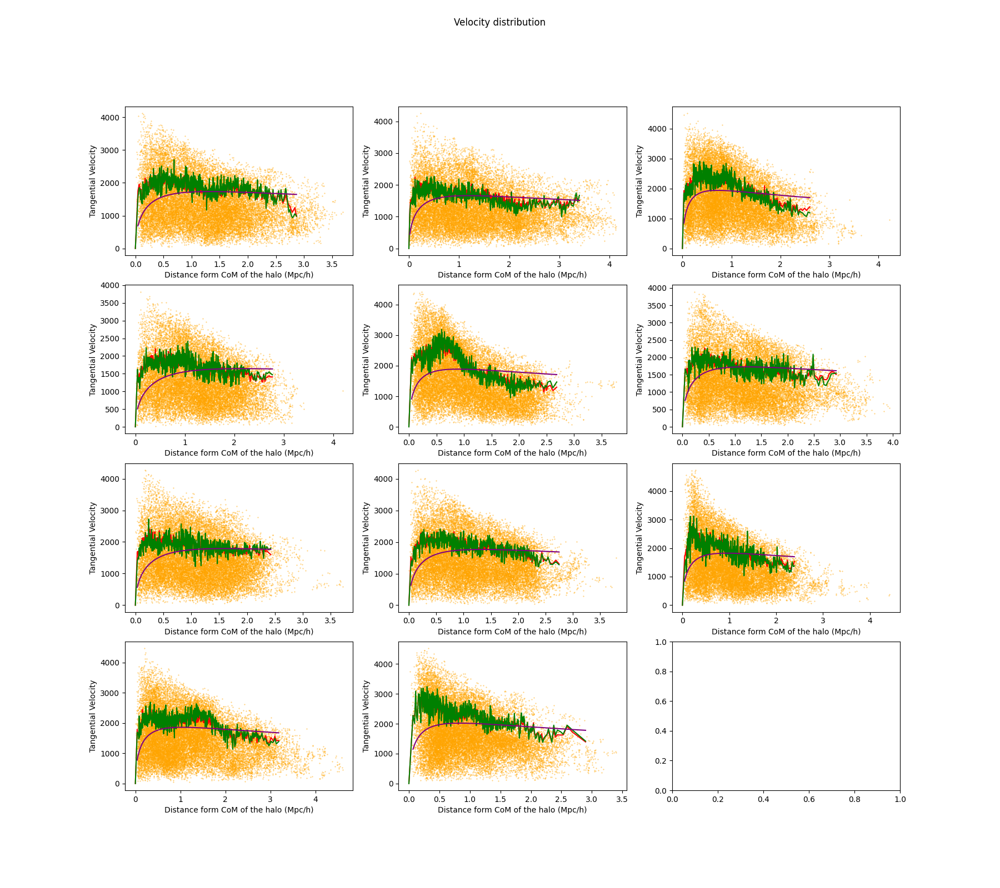

In [137]:
col=3
#Index of the halo
fig2_3, ax2 = plt.subplots(nrows=(math.ceil(len(halos)/col)), ncols=col,figsize=(18, int(1.5*len(halos))))
rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]

i=0
for num in mass_range[:]:
    
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    #r1=r_max*.1
    r1=.8
    r2=1.5
    #r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    m2=len(np.where(x_r<=r2)[0])* 100/3 * m
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    rho_s=f_rho_s(r_s,r1,m1)

    #v_calc=vel(r,rho_s,r_s)
    
    # Select the subsample particle associated with  a halo
    s = cat.halos["npstartA"][num]
    M = cat.halos["npoutA"][num]

    # Velocity of CoM of the host halo
    # Find the velocity of each subsample particles
    # relative to CoM of the halo
    
    # Calculate the distance between CoM of the host halo and to all subsample particle

    #xvarr = np.delete(xvarr, 0, 0)
    # Find the velocity of each subsample particles
    varr =np.array(cat.subsamples["vel"][s:s+M])# velocity in cartitian coordinate

    
    vhalo=np.array(cat.halos["v_com"][num]) # velcity of CoM of halo
    
    v_rel=varr-vhalo
    B    =np.array(cat.subsamples["pos"][s:s+M])
    #print(len(B))
    xhalo=np.array(cat.halos["x_com"][num]) #  CoM position of halo
    x_par=x2r(xhalo)# postion of subsample particle in the universal coordiante system
    x_rel=B-xhalo
    # radial distance of subsample particles
    B=np.array([v_rel[0]*x_rel[0]/x_par[0]])
    for h in range(1,len(x_par)):
        B=np.concatenate((B,[v_rel[h]*x_rel[h]/x_par[h]]),axis=0)#
        #print(v_rad)
    #print(len(B))
    v_rad=x2r(np.array([0,0,0]))
    
    B=v_rel
    v_mag=x2r(np.array([0,0,0]))
    
    # Caluclate tangential velocity
    v_tan=np.sqrt(v_mag**2 - v_rad**2)

    xvarr=np.array([0,0,0])    
    v_result=np.sqrt((v_rel**2).sum(-1))
    v_mag=v_mag[:,0]
    x_par=x_par[:,0]
    arr=np.array([v_mag,x_par])
    arr=arr.transpose()
    #print(arr)
    arr = arr[arr[:, 1].argsort()]
    arr=arr.transpose()
    nchunk=500
    chunk = int(len(arr[0,:])/nchunk)
    xvarr=np.array([0,0,0])
    for j in range(0,(nchunk-1)*chunk,chunk):
        #print(j)
        #print(m)
        #print(arr[0,4:100])
        v_avg=sum(arr[0,j:j+chunk])/chunk
        v_med=arr[0,j:j+chunk]
        v_med = v_med[v_med.argsort()]
        v_med=v_med[int(chunk/2)]
        #print(v_med)
        a=arr[1,j+int(chunk/2)]
        xvrow=np.array([a,v_avg,v_med])
        #print(xvrow)
        xvarr=np.vstack((xvarr,xvrow))
    #print(xvarr)
    ax2[int(i/col),int(i%col)].scatter(x_par, v_tan,s=.1,color="orange")
    ax2[int(i/col),int(i%col)].plot(xvarr[:,0],xvarr[:,1],color='red')
    ax2[int(i/col),int(i%col)].plot(xvarr[:,0],xvarr[:,2],color='green')
    ax2[int(i/col),int(i%col)].plot(xvarr[:,0],vel(xvarr[:,0],rho_s,r_s),color='purple')
    #ax2[int(i/col),int(i%col)].plot(xvarr[:,0],vel(xvarr[:,0],params_arr[i,0],params_arr[i,0]),color='blue')
    #ax2[int(i/col),int(i%col)].plot(xvarr[:,0],vel(xvarr[:,0],params_arr[0,0],.00001),color='blue')
    ax2[int(i/col),int(i%col)].set_ylabel("Tangential Velocity")
    #ax2.scatter(r_to_par,np.abs(v_rel),s=.1)
    ax2[int(i/col),int(i%col)].set_xlabel("Distance form CoM of the halo (Mpc/h)")
    #ax2[int(i/col),int(i%col)].set_ylabel("Velocity w.r.t CoM (km/s)")
    #ax2[int(i/col),int(i%col)].legend(loc='upper right')
    fig2_3.suptitle('Velocity distribution')
    i=i+1
#ax2.set_ylabel("Tangential Velocity")
plt.show()

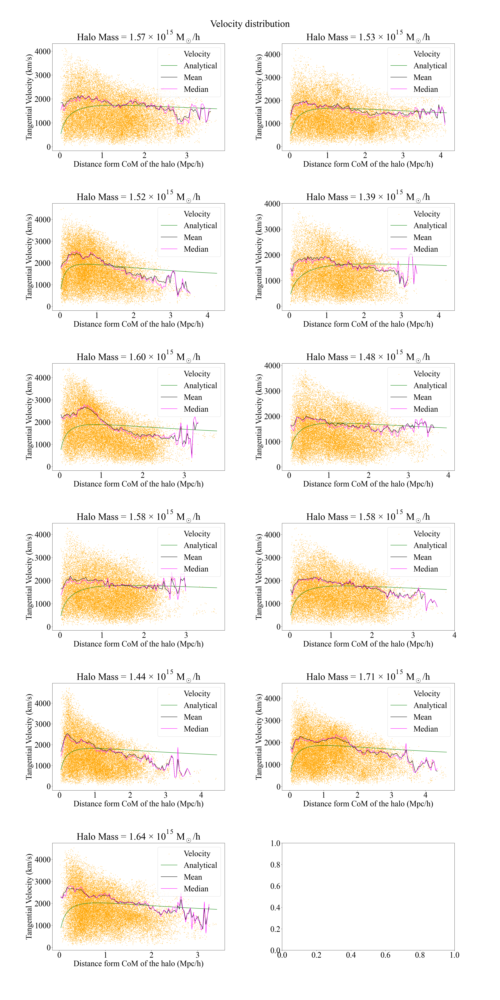

In [154]:
col=2
#Index of the halo
fig2_3, ax2 = plt.subplots(nrows=(math.ceil(len(halos)/col)), ncols=col,figsize=(30,60))#,sharey='row', sharex='col'))
rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]
fig2_3.tight_layout(pad=5.0)
i=0
#for num in mass_range[:len1(mass_range)]:
for num in mass_range[0:len(mass_range)]:
        
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    #r1=r_max*.1
    r1=.8
    r2=1.5
    #r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    m2=len(np.where(x_r<=r2)[0])* 100/3 * m
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    rho_s=f_rho_s(r_s,r1,m1)

    #v_calc=vel(r,rho_s,r_s)
    
    # Select the subsample particle associated with  a halo

    # Velocity of CoM of the host halo
    # Find the velocity of each subsample particles
    # relative to CoM of the halo
    
    # Calculate the distance between CoM of the host halo and to all subsample particle

    #xvarr = np.delete(xvarr, 0, 0)
    # Find the velocity of each subsample particles
    varr =np.array(cat.subsamples["vel"][s:s+M])# velocity in cartitian coordinate

    
    vhalo=np.array(cat.halos["v_com"][num]) # velcity of CoM of halo
    
    v_rel=varr-vhalo
    B    =np.array(cat.subsamples["pos"][s:s+M])
    #print(len(B))
    xhalo=np.array(cat.halos["x_com"][num]) #  CoM position of halo
    x_par=x2r(xhalo)# postion of subsample particle in the universal coordiante system
    x_rel=B-xhalo #   ----------------------?
    # radial distance of subsample particles
    B=np.array([v_rel[0]*x_rel[0]/x_par[0]])
    for h in range(1,len(x_par)):
        B=np.concatenate((B,[v_rel[h]*x_rel[h]/x_par[h]]),axis=0) #
    v_rad=x2r(np.array([0,0,0]))
    
    B=v_rel
    v_mag=x2r(np.array([0,0,0]))
    
    # Caluclate tangential velocity
    v_tan=np.sqrt(v_mag**2 - v_rad**2)
    
    xvarr=np.array([0,0,0])    
    v_result=np.sqrt((v_rel**2).sum(-1))
    v_mag=v_mag[:,0]
    x_par=x_par[:,0]
    arr=np.array([v_mag,x_par])
    arr=arr.transpose()
    arr = arr[arr[:, 1].argsort()]
    arr=arr.transpose()
    nchunk=100
    x_v=np.linspace(min(x_par),max(x_par),nchunk+1)
    chunk = int(len(x_v)/nchunk)
    xvarr=np.array([0,0,0])
    v_avg=[]
    v_med=[]
    for j in range(len(x_v)-1):
        vs_in_chunk=arr[0,np.where((arr[1,:]>x_v[j]) & (arr[1,:]<x_v[j+1]))[0]]
        v_chunk = np.mean(vs_in_chunk)
        v_avg=np.append(v_avg,v_chunk)
        v_sort=np.sort(arr[0,np.where((arr[1,:]>x_v[j]) & (arr[1,:]<x_v[j+1]))[0]])
        if(len(v_sort)==0):
            break
        if len(v_sort)%2==0:
            v_med1=(v_sort[int(len(v_sort)/2)]+v_sort[int(math.ceil(len(v_sort)/2))])/2
        else:
            v_med1=v_sort[int(len(v_sort)/2)]
        v_med=np.append(v_med,v_med1)

    x_v=x_v+(x_v[1]-x_v[0])/2
    x_v1=x_v[:len(v_avg)]
    x_v2=x_v[:len(v_med)]
    ax2[int(i/col),int(i%col)].scatter(x_par, v_tan,s=1,color="orange", label="Velocity")
    ax2[int(i/col),int(i%col)].plot(x_v,vel(x_v,rho_s,r_s),color='green', label="Analytical")
    ax2[int(i/col),int(i%col)].plot(x_v1,v_avg,color='black',label="Mean")
    ax2[int(i/col),int(i%col)].plot(x_v2,v_med,color='magenta', label="Median")

    ax2[int(i/col),int(i%col)].set_ylabel("Tangential Velocity (km/s)")
    #ax2.scatter(r_to_par,np.abs(v_rel),s=.1)
    ax2[int(i/col),int(i%col)].set_xlabel("Distance form CoM of the halo (Mpc/h)")
    ax2[int(i/col),int(i%col)].legend()
    #ax2[int(i/col),int(i%col)].set_ylabel("Velocity w.r.t CoM (km/s)")
    #ax2[int(i/col),int(i%col)].legend(loc='upper right')
    exp=str(len(str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0)))-3)
    mand=str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0))
    mand=mand[0]+"."+mand[1:3]
    p=np.round(params_arr[i,0],2)
    rad=np.round(params_arr[i,1],2)
    ax2[int(i/col),int(i%col)].title.set_text(f'Halo Mass = {mand} $\u00d7$ $10^1$$^{exp[1]}$ $M_\odot/h$')    
    ax2[int(i/col),int(i%col)].title.set_text(f'Halo Mass = {mand} $\u00d7$ $10^1$$^{exp[1]}$ $M_\odot/h$')    
    #ax2[int(i/col),int(i%col)].title.set_text(f'Halo Mass = {mand} $\u00d7$ $10^1$$^{exp[1]}$ $M_\odot/h$; \nparameters: $\u03C1_s$={np.round(rho_s,0)}, $r_S$ = {np.round(r_s,4)}')
    fig2_3.suptitle('Velocity distribution')
    i=i+1
#ax2.set_ylabel("Tangential Velocity")
plt.show()

In [95]:
from itertools import combinations as comb
Rs=np.arange(.4,2.0,0.2)
c=comb(Rs,2)
c=list(c)
c[1][0]

0.5

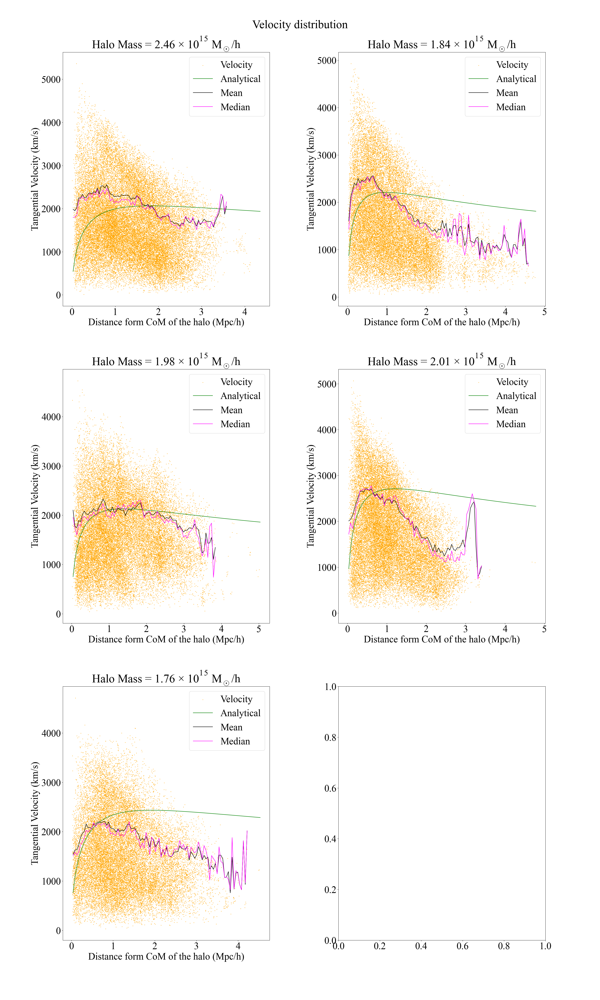

In [134]:
col=2
#Index of the halo
fig2_3, ax2 = plt.subplots(nrows=(math.ceil(len(halos)/col)), ncols=col,figsize=(30,50))#,sharey='row', sharex='col'))
rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]
fig2_3.tight_layout(pad=5.0)
i=0
Rs=np.arange(.4,2.0,0.15)
cd=list(comb(Rs,2))
for m in range(len(cd)):
    t1=cd[m][0]
    t2=cd[m][1]
    if t1>t2:
        cd[m]=[t2,t1]
    else:
        cd[m]=[t1,t2]
#print(cd)
for num in mass_range[:len(mass_range)]:
    
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    #r1=r_max*.1
    r_s=0
    rho_s=0
    p=0
    for t in cd:
        try:
            r1=t[0]
            r2=t[1]
            #r2=r_max*.5
            m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
            m2=len(np.where(x_r<=r2)[0])* 100/3 * m
            r_s1=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
            
            r_s=r_s+r_s1
            rho_s=rho_s+f_rho_s(r_s1,r1,m1)
            p+=1
        except:
            pass
        #print(r1,r2)
    r_s=r_s/p
    rho_s=rho_s/p
    #v_calc=vel(r,rho_s,r_s)
    
    # Select the subsample particle associated with  a halo

    # Velocity of CoM of the host halo
    # Find the velocity of each subsample particles
    # relative to CoM of the halo
    
    # Calculate the distance between CoM of the host halo and to all subsample particle

    #xvarr = np.delete(xvarr, 0, 0)
    # Find the velocity of each subsample particles
    varr =np.array(cat.subsamples["vel"][s:s+M])# velocity in cartitian coordinate

    
    vhalo=np.array(cat.halos["v_com"][num]) # velcity of CoM of halo
    
    v_rel=varr-vhalo
    B    =np.array(cat.subsamples["pos"][s:s+M])
    #print(len(B))
    xhalo=np.array(cat.halos["x_com"][num]) #  CoM position of halo
    x_par=x2r(xhalo)# postion of subsample particle in the universal coordiante system
    x_rel=B-xhalo #   ----------------------?
    # radial distance of subsample particles
    B=np.array([v_rel[0]*x_rel[0]/x_par[0]])
    for h in range(1,len(x_par)):
        B=np.concatenate((B,[v_rel[h]*x_rel[h]/x_par[h]]),axis=0) #
    v_rad=x2r(np.array([0,0,0]))
    
    B=v_rel
    v_mag=x2r(np.array([0,0,0]))
    
    # Caluclate tangential velocity
    v_tan=np.sqrt(v_mag**2 - v_rad**2)
    
    xvarr=np.array([0,0,0])    
    v_result=np.sqrt((v_rel**2).sum(-1))
    v_mag=v_mag[:,0]
    x_par=x_par[:,0]
    arr=np.array([v_mag,x_par])
    arr=arr.transpose()
    arr = arr[arr[:, 1].argsort()]
    arr=arr.transpose()
    nchunk=100
    x_v=np.linspace(min(x_par),max(x_par),nchunk+1)
    chunk = int(len(x_v)/nchunk)
    xvarr=np.array([0,0,0])
    v_avg=[]
    v_med=[]
    for j in range(len(x_v)-1):
        vs_in_chunk=arr[0,np.where((arr[1,:]>x_v[j]) & (arr[1,:]<x_v[j+1]))[0]]
        v_chunk = np.mean(vs_in_chunk)
        v_avg=np.append(v_avg,v_chunk)
        v_sort=np.sort(arr[0,np.where((arr[1,:]>x_v[j]) & (arr[1,:]<x_v[j+1]))[0]])
        if(len(v_sort)==0):
            break
        if len(v_sort)%2==0:
            v_med1=(v_sort[int(len(v_sort)/2)]+v_sort[int(math.ceil(len(v_sort)/2))])/2
        else:
            v_med1=v_sort[int(len(v_sort)/2)]
        v_med=np.append(v_med,v_med1)

    x_v=x_v+(x_v[1]-x_v[0])/2
    x_v1=x_v[:len(v_avg)]
    x_v2=x_v[:len(v_med)]
    ax2[int(i/col),int(i%col)].scatter(x_par, v_tan,s=1,color="orange", label="Velocity")
    ax2[int(i/col),int(i%col)].plot(x_v,vel(x_v,rho_s,r_s),color='green', label="Analytical")
    ax2[int(i/col),int(i%col)].plot(x_v1,v_avg,color='black',label="Mean")
    ax2[int(i/col),int(i%col)].plot(x_v2,v_med,color='magenta', label="Median")

    ax2[int(i/col),int(i%col)].set_ylabel("Tangential Velocity (km/s)")
    #ax2.scatter(r_to_par,np.abs(v_rel),s=.1)
    ax2[int(i/col),int(i%col)].set_xlabel("Distance form CoM of the halo (Mpc/h)")
    ax2[int(i/col),int(i%col)].legend()
    #ax2[int(i/col),int(i%col)].set_ylabel("Velocity w.r.t CoM (km/s)")
    #ax2[int(i/col),int(i%col)].legend(loc='upper right')
    exp=str(len(str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0)))-3)
    mand=str(np.round(cat.halos["N"][num]*cat.header["ParticleMassHMsun"],0))
    mand=mand[0]+"."+mand[1:3]
    p=np.round(params_arr[i,0],2)
    rad=np.round(params_arr[i,1],2)
    ax2[int(i/col),int(i%col)].title.set_text(f'Halo Mass = {mand} $\u00d7$ $10^1$$^{exp[1]}$ $M_\odot/h$')    
    ax2[int(i/col),int(i%col)].title.set_text(f'Halo Mass = {mand} $\u00d7$ $10^1$$^{exp[1]}$ $M_\odot/h$')    
    #ax2[int(i/col),int(i%col)].title.set_text(f'Halo Mass = {mand} $\u00d7$ $10^1$$^{exp[1]}$ $M_\odot/h$; \nparameters: $\u03C1_s$={np.round(rho_s,0)}, $r_S$ = {np.round(r_s,4)}')
    fig2_3.suptitle('Velocity distribution')
    i=i+1
#ax2.set_ylabel("Tangential Velocity")
plt.show()

In [123]:
cat.halos['npoutA'][1265]

168

## Rotation Curves Combined

18
2.33 × $10^15$


/tmp/ipykernel_1552/1340263715.py:5: RuntimeWarning: divide by zero encountered in divide
  return(np.sqrt(l*4*np.pi*G*rho*r_s**3/r*(np.log(1+r/r_s)-r/r_s/(r/r_s+1))))#*cat.header["H0"]/100)
/tmp/ipykernel_1552/1340263715.py:5: RuntimeWarning: invalid value encountered in multiply
  return(np.sqrt(l*4*np.pi*G*rho*r_s**3/r*(np.log(1+r/r_s)-r/r_s/(r/r_s+1))))#*cat.header["H0"]/100)


18
2.28 × $10^15$
18
2.26 × $10^15$
18
2.07 × $10^15$
18
2.37 × $10^15$
18
2.20 × $10^15$
18
2.35 × $10^15$
18
2.35 × $10^15$
18
2.14 × $10^15$
18
2.54 × $10^15$
18
2.44 × $10^15$


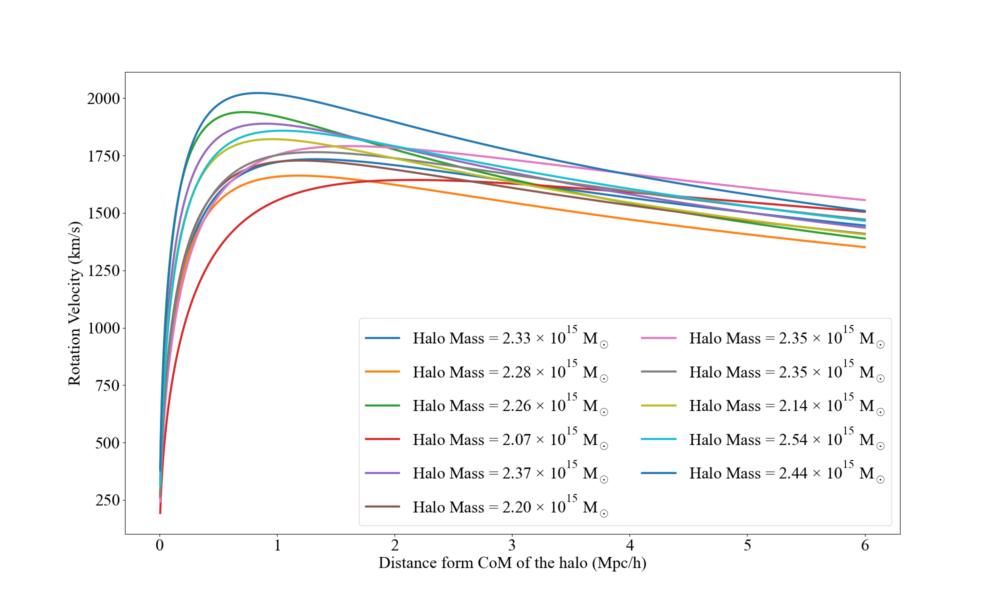

In [158]:
col=3
#Index of the halo
fig2_3=plt.figure(figsize=(20, 12))

plt.rcParams["font.size"]=24
rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]
i=0
for num in mass_range[:]:http://localhost:8888/doc/tree/Project_NFW_fitting.ipynb#Rotation-Curves-Combined
    
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    #r1=r_max*.1
    r1=.8
    r2=1.5
    #r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    m2=len(np.where(x_r<=r2)[0])* 100/3 * m
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    rho_s=f_rho_s(r_s,r1,m1)

    
    x_v=np.linspace(0,6,1000)
    lab=str(np.round((cat.halos["N"][num]*cat.header["ParticleMassMsun"]),2))
    print(len(lab))
    print(f"{lab[0]}.{lab[1:3]} \u00D7 $10^{len(lab)-3}$")
    expo=str(len(lab)-3)
    lab2=f"Halo Mass = {lab[0]}.{lab[1:3]}"
    plt.plot(x_v,vel(x_v,rho_s,r_s), label="%s \u00D7 $10^{%s}$ $M_\odot$"%(lab2,expo),linewidth=3)
    plt.ylabel("Rotation Velocity (km/s)")
    #ax2.scatter(r_to_par,np.abs(v_rel),s=.1)
    plt.xlabel("Distance form CoM of the halo (Mpc/h)")
    
    #ax2[int(i/col),int(i%col)].set_ylabel("Velocity w.r.t CoM (km/s)")
    #ax2[int(i/col),int(i%col)].legend(loc='upper right')
    i=i+1
plt.legend(loc='lower right',ncol=2)
#ax2.set_ylabel("Tangential Velocity")
plt.show()

In [5]:
cat.header

{'AllowGroupFinding': 1,
 'BackupDirectory': '/gpfs/alpine/proj-shared/ast145/AbacusSummit/AbacusSummit_base_c000_ph000',
 'BackupStepInterval': -1,
 'BoxSize': 2000.0,
 'BoxSizeHMpc': 2000.0,
 'BoxSizeMpc': 2969.1211401425176,
 'CPD': 1701,
 'CodeVersion': '8d43e2d166b9bcb0168a6ca49a4643d06bfb2625',
 'Conv_IOCores': 0,
 'Conv_IOMode': 'overwrite',
 'Conv_OMP_NUM_THREADS': 42,
 'Conv_OMP_PLACES': '{0}:21:4,{88}:21:4',
 'Conv_OMP_PROC_BIND': 'spread',
 'Conv_zwidth': 0,
 'ConvolutionCacheSizeMB': 200,
 'ConvolutionL1CacheSizeMB': 0.015625,
 'CoordinateDistanceHMpc': 292.5861830707283,
 'DeleteICsAfterFirstBackup': 1,
 'DeltaEtaDrift': 0.0007023815099787001,
 'DeltaRedshift': 0.000670922877507,
 'DeltaScaleFactor': 0.000554143728125,
 'DeltaTime': 0.000580126734663,
 'DensityKernelRad': 0.4,
 'DensityKernelRad2': 3.34898e-09,
 'DerivativeExpansionRadius': 8,
 'DerivativesDirectory': '/gpfs/alpine/proj-shared/ast145/Derivatives',
 'DirectBPD': 2,
 'Do2LPTVelocityRereading': 0,
 'DoublePre

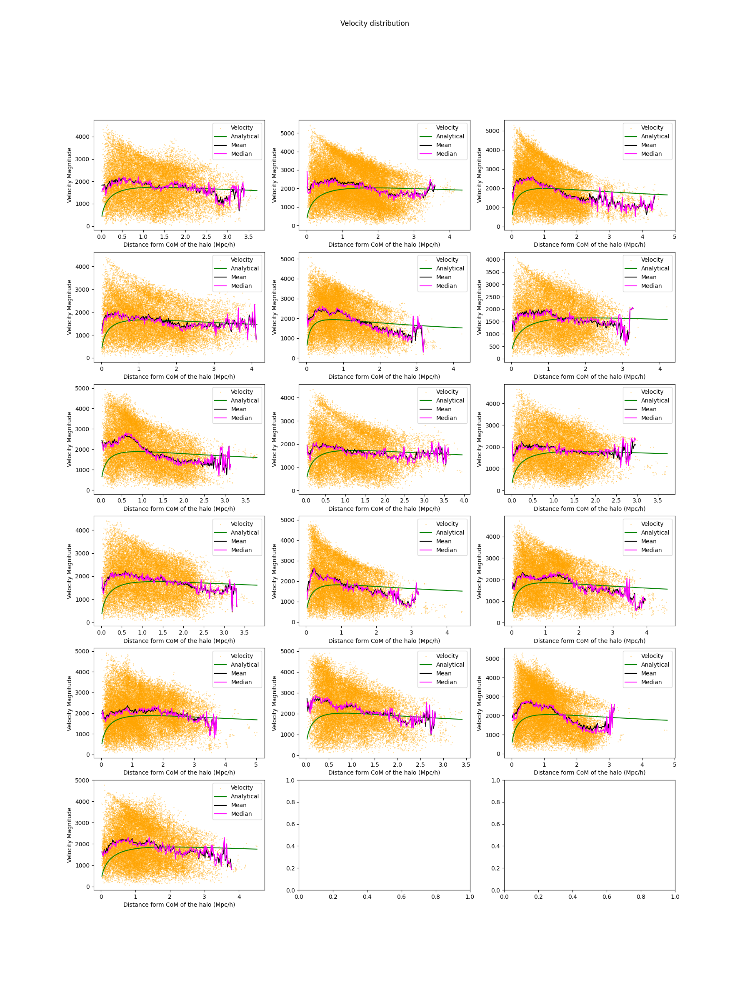

In [98]:
col=3
#Index of the halo
fig2_3, ax2 = plt.subplots(nrows=(math.ceil(len(halos)/col)), ncols=col,figsize=(18, int(1.5*len(halos))))
rho_mean=cat.halos["N"].sum()/(2000**3/34)*cat.header["ParticleMassHMsun"]

i=0
for num in mass_range[:]:
    
    m= cat.header["ParticleMassHMsun"]
    s=cat.halos["npstartA"][num]
    M=cat.halos["npoutA"][num]
    B=cat.subsamples["pos"][s:s+M]
    x_r=x2r(cat.halos["x_com"][num])
    r_max=x_r.max()
    r1=.8
    r2=1.5
    #r2=r_max*.5
    m1=len(np.where(x_r<=r1)[0])* 100/3 * m  # Because there are 3 percentage of subsample particles
    m2=len(np.where(x_r<=r2)[0])* 100/3 * m
    r_s=fsolve(f_rs, .1, (r1, r2, m1, m2))[0]
    rho_s=f_rho_s(r_s,r1,m1)

    #v_calc=vel(r,rho_s,r_s)
    
    # Select the subsample particle associated with  a halo

    # Velocity of CoM of the host halo
    # Find the velocity of each subsample particles
    # relative to CoM of the halo
    
    # Calculate the distance between CoM of the host halo and to all subsample particle

    #xvarr = np.delete(xvarr, 0, 0)
    # Find the velocity of each subsample particles
    varr =np.array(cat.subsamples["vel"][s:s+M])# velocity in cartitian coordinate

    
    vhalo=np.array(cat.halos["v_com"][num]) # velcity of CoM of halo
    
    v_rel=varr-vhalo
    B    =np.array(cat.subsamples["pos"][s:s+M])
    #print(len(B))
    xhalo=np.array(cat.halos["x_com"][num]) #  CoM position of halo
    x_par=x2r(xhalo)# postion of subsample particle in the universal coordiante system
    x_rel=B-xhalo #   ----------------------?
    # radial distance of subsample particles
    
    B=v_rel
    v_mag=x2r(np.array([0,0,0]))
    
    # Caluclate tangential velocity
    #v_tan=np.sqrt(v_mag**2 - v_rad**2)
    v_tan=v_mag
    
    xvarr=np.array([0,0,0])    
    v_result=np.sqrt((v_rel**2).sum(-1))
    v_mag=v_mag[:,0]
    x_par=x_par[:,0]
    arr=np.array([v_mag,x_par])
    arr=arr.transpose()
    arr = arr[arr[:, 1].argsort()]
    arr=arr.transpose()
    nchunk=200
    x_v=np.linspace(min(x_par),max(x_par),nchunk+1)
    chunk = int(len(x_v)/nchunk)
    xvarr=np.array([0,0,0])
    v_avg=[]
    v_med=[]
    for j in range(len(x_v)-1):
        vs_in_chunk=arr[0,np.where((arr[1,:]>x_v[j]) & (arr[1,:]<x_v[j+1]))[0]]
        v_chunk = np.mean(vs_in_chunk)
        v_avg=np.append(v_avg,v_chunk)
        v_sort=np.sort(arr[0,np.where((arr[1,:]>x_v[j]) & (arr[1,:]<x_v[j+1]))[0]])
        if(len(v_sort)==0):
            break
        if len(v_sort)%2==0:
            v_med1=(v_sort[int(len(v_sort)/2)]+v_sort[int(math.ceil(len(v_sort)/2))])/2
        else:
            v_med1=v_sort[int(len(v_sort)/2)]
        v_med=np.append(v_med,v_med1)

    x_v=x_v+(x_v[1]-x_v[0])/2
    x_v1=x_v[:len(v_avg)]
    x_v2=x_v[:len(v_med)]
    ax2[int(i/col),int(i%col)].scatter(x_par, v_tan,s=.1,color="orange", label="Velocity")
    ax2[int(i/col),int(i%col)].plot(x_v,vel(x_v,rho_s,r_s),color='green', label="Analytical")
    ax2[int(i/col),int(i%col)].plot(x_v1,v_avg,color='black',label="Mean")
    ax2[int(i/col),int(i%col)].plot(x_v2,v_med,color='magenta', label="Median")

    ax2[int(i/col),int(i%col)].set_ylabel("Velocity Magnitude")
    #ax2.scatter(r_to_par,np.abs(v_rel),s=.1)
    ax2[int(i/col),int(i%col)].set_xlabel("Distance form CoM of the halo (Mpc/h)")
    ax2[int(i/col),int(i%col)].legend()
    #ax2[int(i/col),int(i%col)].set_ylabel("Velocity w.r.t CoM (km/s)")
    #ax2[int(i/col),int(i%col)].legend(loc='upper right')
    fig2_3.suptitle('Velocity distribution')
    i=i+1
#ax2.set_ylabel("Tangential Velocity")
plt.show()

In [60]:
A=np.linspace(1,9,100)
np.where(A<6)[0]

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61])

In [70]:
print(r_to_par)
print(len(r_to_par)

[4.032959  4.1450195 3.7749634 ... 4.2750244 4.361023  4.359009 ]
28581


In [40]:
print(r_to_par)


          pos          
-----------------------
1.5652466 .. 0.84295654
 1.4432373 .. 1.0750122
 1.8171997 .. 1.4890137
 1.9072266 .. 1.4489746
 1.7651978 .. 1.3369751
 1.6852417 .. 1.3670044
 1.8511963 .. 1.3070068
                    ...
1.4588013 .. 0.71502686
  1.4887695 .. 0.743042
  1.520752 .. 0.7250366
0.72875977 .. 0.6790161
 0.8632202 .. 1.6290283
0.86120605 .. 1.6370239
 0.9212036 .. 1.5950317
 0.8792114 .. 1.6190186
Length = 28581 rows


In [ ]:
v_At_r=density(r,v2r,s,)

In [ ]:
v_result=np.sqrt((v_rel**2).sum(-1))

In [42]:
A=density(r,v_result,s,cat.subsamples['vel'])

vel=A[0]
l=A[1]
m=np.where(vel==max(vel))
m=m[0][0]
x=(r[m:l])
y=(vel[m:l])

In [28]:
def plot_halos(mass_range,samp_frac):    
    import random
    import math
    #Index of the halo

    #samp_frac= 5  # percentage
    i=0
    col=3
    fig, ax3 = plt.subplots(nrows=(math.ceil(len(mass_range)/col)), ncols=col,figsize=(18, int(1.5*len(halos))),subplot_kw={'projection': '3d'})
    #fig = plt.figure(figsize=plt.figaspect(0.5))
    #ax3 = fig.add_subplot(projection='3d')

    for idx in mass_range:
        s=cat.halos["npstartA"][idx]
        M=cat.halos["npoutA"][idx]
        x_h=cat.halos["x_com"][idx]

    #    x_b=np.array(cat.subsamples['pos'][s:s+M,0])
    #    y_b=cat.subsamples['pos'][s:s+M,1]
    #    z_b=cat.subsamples['pos'][s:s+M,2]
        rand_pos=np.array(random.sample(list(cat.subsamples['pos'][s:s+M]), int(len(cat.subsamples["pos"][s:s+M])*samp_frac/100)))
        x_b=rand_pos[:,0]
        y_b=rand_pos[:,1]
        z_b=rand_pos[:,2]
        plt.title("Subsample Particles")
        #ax3.scatter3D(x_b,y_b,z_b,alpha=.1)
        ax3[int(i/col),int(i%col)].scatter(x_b,y_b,z_b,alpha=.1)
    #    ax3[int(i/col),int(i%col)].scatter3D(x_h[0],x_h[1],x_h[2])
    #    ax3[int(i/col),int(i%col)].set_xlabel("x")
    #    ax3[int(i/col),int(i%col)].set_ylabel("y")
    #    ax3[int(i/col),int(i%col)].set_zlabel("z")
        #ax2[int(i/col),int(i%col)].legend(loc='upper right')
    #    fig.suptitle('Velocity distribution')
        i=i+1
    plt.show()

In [ ]:
plot_halos(mass_range,100)

### Plot velocity vector field

In [ ]:

import random
import math
#Index of the halo

samp_frac= 50  # percentage

#fig, ax3 = plt.subplots(nrows=(math.ceil(len(halos)/col)), ncols=col,figsize=(18, int(1.5*len(halos))),subplot_kw={'projection': '3d'})
#fig = plt.figure(figsize=plt.figaspect(0.5))
#ax3 = fig.add_subplot(projection='3d')
i=0
col=3
fig5=plt.figure()
for idx in mass_range[:1]:
    fig = plt.figure(figsize=(18,18))
    ax3 = plt.axes(projection='3d')
    s=cat.halos["npstartA"][idx]
    M=cat.halos["npoutA"][idx]
    x_h=np.array(cat.halos["x_com"][idx])
    v=np.array(cat.subsamples['vel'][s:s+M])
#    x_b=np.array(cat.subsamples['pos'][s:s+M,0])
#    y_b=cat.subsamples['pos'][s:s+M,1]
#    z_b=cat.subsamples['pos'][s:s+M,2]
    xpos=np.array(cat.subsamples["pos"][s:s+M])
    #print(xpos)
    index_pos=np.arange(len(xpos))
    rand_pos_id=np.array(random.sample(list(index_pos), int(M*samp_frac/100)))
    rand_pos=xpos[rand_pos_id]
    #print(par_ind)
    v_samp=v[rand_pos_id]-cat.halos["v_com"][idx]
    
    plt.title("Subsample Particles")
    #ax3.scatter3D(x_b,y_b,z_b,alpha=.1)
    ax3.scatter(rand_pos[:,0],rand_pos[:,1],rand_pos[:,2],alpha=.5)
    ax3.scatter3D(x_h[0],x_h[1],x_h[2])
#    ax3[int(i/col),int(i%col)].set_xlabel("x")
#    ax3[int(i/col),int(i%col)].set_ylabel("y")
#    ax3[int(i/col),int(i%col)].set_zlabel("z")
#    ax2[int(i/col),int(i%col)].legend(loc='upper right')
#    fig.suptitle('Velocity distribution')
    o=np.repeat(np.array([x_h,]),len(rand_pos),axis=0)
    #print(o[:,0])
    #pos_vec=rand_pos-x_h
    #print(pos_vec)
    ax3.quiver(rand_pos[:,0],rand_pos[:,1],rand_pos[:,2], v_samp[:,0], v_samp[:,1], v_samp[:,2], length=0.0001)
    #ax3.quiver(o[:,0],o[:,1],o[:,2],pos_vec[:,0],pos_vec[:,1],pos_vec[:,2],color="red", length=2)

    i=i+1
plt.show()

In [10]:
def plot_1halo(idx):
    
    s=cat.halos["npstartA"][idx]
    M=cat.halos["npoutA"][idx]
    x_h=cat.halos["x_com"][idx]
    
    x_b=cat.subsamples['pos'][s:s+M,0]
    y_b=cat.subsamples['pos'][s:s+M,1]
    z_b=cat.subsamples['pos'][s:s+M,2]
    
    fig = plt.figure(figsize = (10, 7))
    ax = plt.axes(projection ="3d")
    ax.scatter3D(x_b,y_b,z_b,alpha=.1)
    ax.scatter3D(x_h[0],x_h[1],x_h[2])
    plt.title("Subsample Particles")
    plt.show()
   